<a href="https://colab.research.google.com/github/Einsteinious/Google-colab/blob/main/Data_analysis_of_job_salaries_(Data).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

<font color="lightblue">Loading the csv file from the drive and showing a sample of the first 5 and last 5 rows with all the relevant columns. At the bottom of the table we can also read the total of the rows and columns.

In [ ]:
import pandas as pd
path="/content/drive/MyDrive/Colab Notebooks/OESON programming/jobs_in_data.csv"
jobsdata=pd.read_csv(path)
jobsdata

,work_year,job_title,job_category,salary_currency,salary,salary_in_usd,employee_residence,experience_level,employment_type,work_setting,company_location,company_size
0,2023,Data DevOps Engineer,Data Engineering,EUR,88000,95012,Germany,Mid-level,Full-time,Hybrid,Germany,L
1,2023,Data Architect,Data Architecture and Modeling,USD,186000,186000,United States,Senior,Full-time,In-person,United States,M
2,2023,Data Architect,Data Architecture and Modeling,USD,81800,81800,United States,Senior,Full-time,In-person,United States,M
3,2023,Data Scientist,Data Science and Research,USD,212000,212000,United States,Senior,Full-time,In-person,United States,M
4,2023,Data Scientist,Data Science and Research,USD,93300,93300,United States,Senior,Full-time,In-person,United States,M
...,...,...,...,...,...,...,...,...,...,...,...,...
9350,2021,Data Specialist,Data Management and Strategy,USD,165000,165000,United States,Senior,Full-time,Remote,United States,L
9351,2020,Data Scientist,Data Science and Research,USD,412000,412000,United States,Senior,Full-time,Remote,United States,L
9352,2021,Principal Data Scientist,Data Science and Research,USD,151000,151000,United States,Mid-level,Full-time,Remote,United States,L
9353,2020,Data Scientist,Data Science and Research,USD,105000,105000,United States,Entry-level,Full-time,Remote,United States,S


<font color="lightblue">Loading some libraries that will be useful for the purpose

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import style
import seaborn as sns
import folium
import plotly.express as px
from folium.plugins import MarkerCluster
from plotnine import ggplot, aes, geom_bar
import plotly.graph_objects as go

<font color="lightblue">Here we see again the different categories analysed (columns) and the total of entries (rows) info

In [ ]:
jobsdata.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9355 entries, 0 to 9354
Data columns (total 12 columns):
 #   Column              Non-Null Count  Dtype 
---  ------              --------------  ----- 
 0   work_year           9355 non-null   int64 
 1   job_title           9355 non-null   object
 2   job_category        9355 non-null   object
 3   salary_currency     9355 non-null   object
 4   salary              9355 non-null   int64 
 5   salary_in_usd       9355 non-null   int64 
 6   employee_residence  9355 non-null   object
 7   experience_level    9355 non-null   object
 8   employment_type     9355 non-null   object
 9   work_setting        9355 non-null   object
 10  company_location    9355 non-null   object
 11  company_size        9355 non-null   object
dtypes: int64(3), object(9)
memory usage: 877.2+ KB


<font color="lightblue">Showing the descriptive statistics.
This fuction gives us a summary of the statistics,that give an overview of the data distribution, (including measures of central tendency, dispersion and shape) and percentile.

In [ ]:
descript_stat=jobsdata[["salary", "salary_in_usd"]].describe()
descript_stat

,salary,salary_in_usd
count,9355.000000,9355.000000
mean,149927.981293,150299.495564
std,63608.835387,63177.372024
min,14000.000000,15000.000000
25%,105200.000000,105700.000000
50%,143860.000000,143000.000000
75%,187000.000000,186723.000000
max,450000.000000,450000.000000


<font color="lightblue">Time frame into consideration 2020-2023

In [ ]:
jobsdata['work_year'].unique()

array([2023, 2022, 2020, 2021])

In [ ]:
frequency_jobs_years=jobsdata['work_year'].value_counts().sort_index()
frequency_jobs_years

2020      71
2021     197
2022    1634
2023    7453
Name: work_year, dtype: int64

<font color="lightblue">We can tell that the number of jobs into the tech field has grown considerably through the years, in particular in the last year, 2023.

<function matplotlib.pyplot.show(close=None, block=None)>

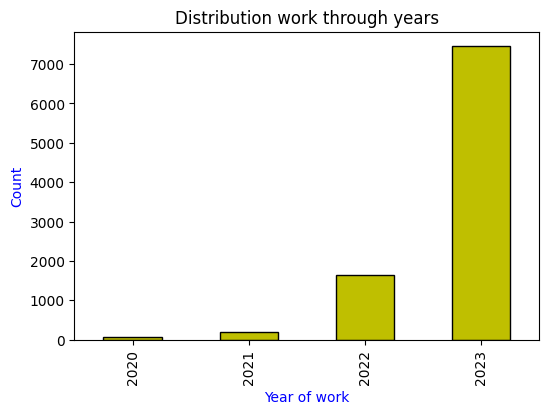

In [ ]:
plt.figure(figsize=(6,4))
frequency_jobs_years.plot(kind='bar',title='Distribution work through years', color='y', edgecolor='black')
plt.xlabel('Year of work', color='blue')
plt.ylabel('Count', color='blue')
plt.show

<font color="lightblue">Here we have all the different job titles that appear in the data

In [ ]:
jobsdata['job_title'].unique()

array(['Data DevOps Engineer', 'Data Architect', 'Data Scientist',
       'Machine Learning Researcher', 'Data Engineer',
       'Machine Learning Engineer', 'Data Analyst', 'Analytics Engineer',
       'Applied Scientist', 'BI Developer',
       'Business Intelligence Engineer', 'Research Scientist',
       'Research Analyst', 'Research Engineer', 'Data Science Engineer',
       'Data Quality Analyst', 'Data Product Manager',
       'Machine Learning Scientist', 'AI Engineer', 'MLOps Engineer',
       'Deep Learning Engineer', 'Data Modeler', 'Data Product Owner',
       'Data Science Consultant', 'Business Intelligence Analyst',
       'AI Developer', 'Data Manager', 'ML Engineer',
       'Data Science Director', 'Head of Data', 'BI Analyst',
       'Data Management Analyst', 'Machine Learning Modeler',
       'Data Specialist', 'BI Data Analyst', 'Data Integration Engineer',
       'Business Intelligence Manager', 'Data Integration Specialist',
       'Data Science Practitioner', 'B

<font color="lightblue">Here we can see how many times each of the job title appears into the data and as also represented from the Length at the bottom, how many different job titles there are in total (to not confuse with job categories that we will see soon).

In [ ]:
common_job_titles=jobsdata['job_title'].unique()
count_common_jobs=jobsdata['job_title'].value_counts()
print("Job title counts\n", count_common_jobs)

jobsdata['job_title'].nunique()
print('\nThere are a total of ', jobsdata['job_title'].nunique(), 'common jobs titles')

Job title counts
 Data Engineer                     2195
Data Scientist                    1989
Data Analyst                      1388
Machine Learning Engineer          991
Applied Scientist                  272
                                  ... 
Consultant Data Engineer             1
Sales Data Analyst                   1
Managing Director Data Science       1
AWS Data Architect                   1
Deep Learning Researcher             1
Name: job_title, Length: 125, dtype: int64

There are a total of  125 common jobs titles


<font color="lightblue">It has been requested to show the most frequent job titles, so here it goes:

In [ ]:
most_frequent_jobs=count_common_jobs.head(20)
most_frequent_jobs

Data Engineer                     2195
Data Scientist                    1989
Data Analyst                      1388
Machine Learning Engineer          991
Applied Scientist                  272
Research Scientist                 269
Analytics Engineer                 256
Data Architect                     213
Business Intelligence Engineer     144
Research Engineer                  144
Data Manager                       132
ML Engineer                        106
Data Science Manager                88
Machine Learning Scientist          76
Business Intelligence Analyst       54
BI Developer                        52
Data Science Consultant             44
Data Specialist                     40
Research Analyst                    39
Decision Scientist                  38
Name: job_title, dtype: int64

<function matplotlib.pyplot.show(close=None, block=None)>

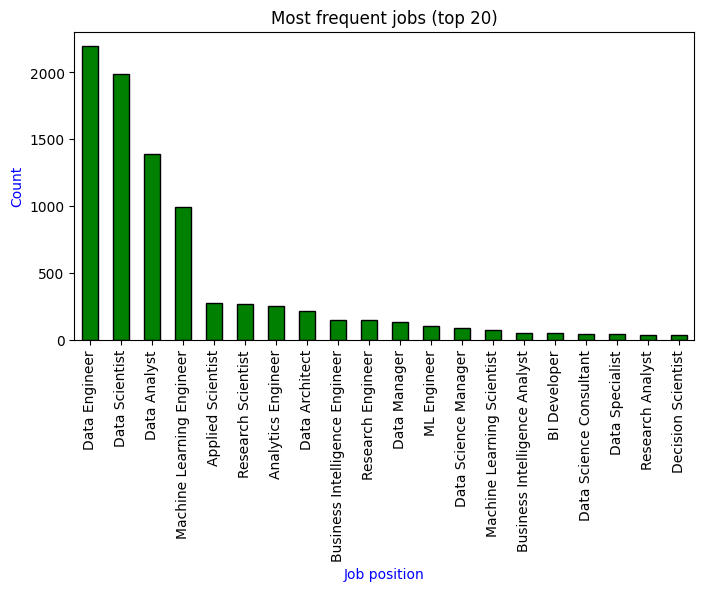

In [ ]:
plt.figure(figsize=(8,4))
most_frequent_jobs.plot(kind='bar',title='Most frequent jobs (top 20)', color='g', edgecolor='black')
plt.xlabel('Job position', color='blue')
plt.ylabel('Count', color='blue')
plt.show

<font color="lightblue">We will analyse now the job categories (not job titles).
Here the job categories:

In [ ]:
jobsdata['job_category'].unique()

array(['Data Engineering', 'Data Architecture and Modeling',
       'Data Science and Research', 'Machine Learning and AI',
       'Data Analysis', 'Leadership and Management',
       'BI and Visualization', 'Data Quality and Operations',
       'Data Management and Strategy', 'Cloud and Database'], dtype=object)

In [ ]:
jobsdata['job_category'].nunique()

10

<font color="lightblue"> and as displayed above the number of job categories are 10. We will show now the distribuition of those.

In [ ]:
common_categories=jobsdata['job_category'].value_counts()
print(common_categories)

Data Science and Research         3014
Data Engineering                  2260
Data Analysis                     1457
Machine Learning and AI           1428
Leadership and Management          503
BI and Visualization               313
Data Architecture and Modeling     259
Data Management and Strategy        61
Data Quality and Operations         55
Cloud and Database                   5
Name: job_category, dtype: int64


<function matplotlib.pyplot.show(close=None, block=None)>

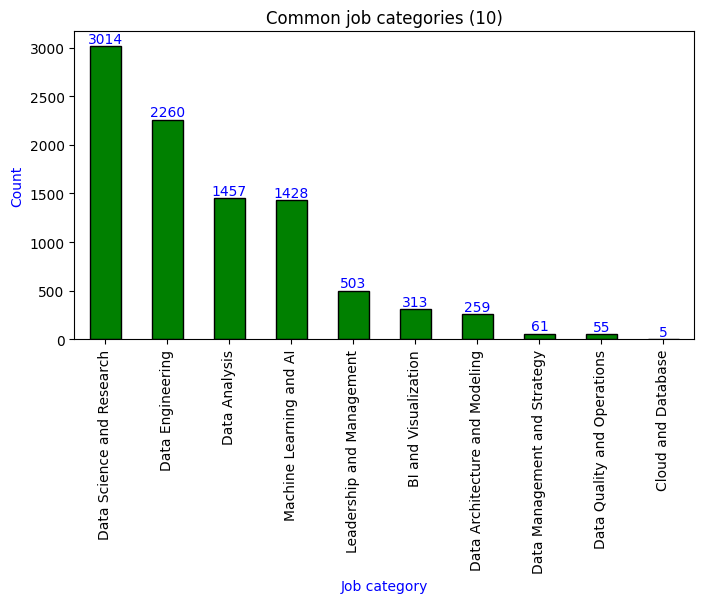

In [ ]:
plt.figure(figsize=(8,4))
common_categories.plot(kind='bar',title='Common job categories (10)', color='g', edgecolor='black')
plt.xlabel('Job category', color='blue')
plt.ylabel('Count', color='blue')
for i, count in enumerate(common_categories):
    plt.text(
        i,
        count,
        str(count),
        ha='center',
        va='bottom',
        color='blue'
    )
plt.show

<font color="lightblue">We will list all the currencies and their occurencies:

In [ ]:
jobsdata['salary_currency'].unique()

array(['EUR', 'USD', 'GBP', 'CAD', 'AUD', 'PLN', 'BRL', 'TRY', 'CHF',
       'SGD', 'DKK'], dtype=object)

In [ ]:
currency_frequency=jobsdata['salary_currency'].value_counts()
currency_frequency

USD    8591
GBP     347
EUR     340
CAD      38
AUD      11
PLN       7
SGD       6
CHF       5
BRL       4
TRY       3
DKK       3
Name: salary_currency, dtype: int64

<font color="lightblue">And represent with the graph, noticing the salaries in dollars are the most present

<function matplotlib.pyplot.show(close=None, block=None)>

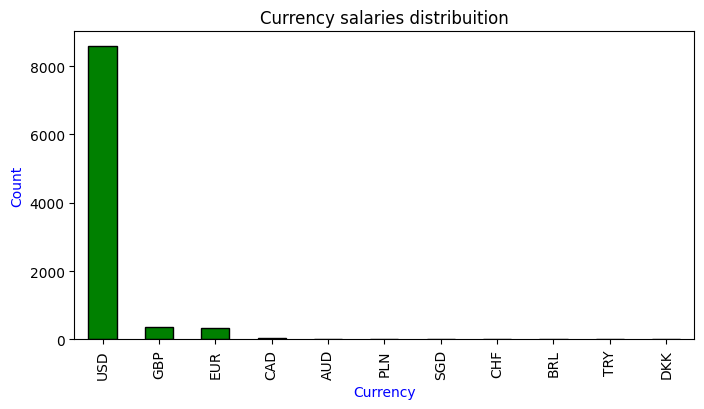

In [ ]:
plt.figure(figsize=(8,4))
currency_frequency.plot(kind='bar',title='Currency salaries distribuition', color='g', edgecolor='black')
plt.xlabel('Currency', color='blue')
plt.ylabel('Count', color='blue')
plt.show

<font color="lightblue"> We will see the type of employment:

In [ ]:
jobsdata['employment_type'].unique()

array(['Full-time', 'Part-time', 'Contract', 'Freelance'], dtype=object)

In [ ]:
n_type_employment=jobsdata['employment_type'].nunique()
print("There are", n_type_employment, "employment type")

There are 4 employment type


In [ ]:
type_employment=jobsdata['employment_type'].value_counts()
type_employment

Full-time    9310
Contract       19
Part-time      15
Freelance      11
Name: employment_type, dtype: int64

<font color="lightblue"> and we can see majority of jobs are full-time

<function matplotlib.pyplot.show(close=None, block=None)>

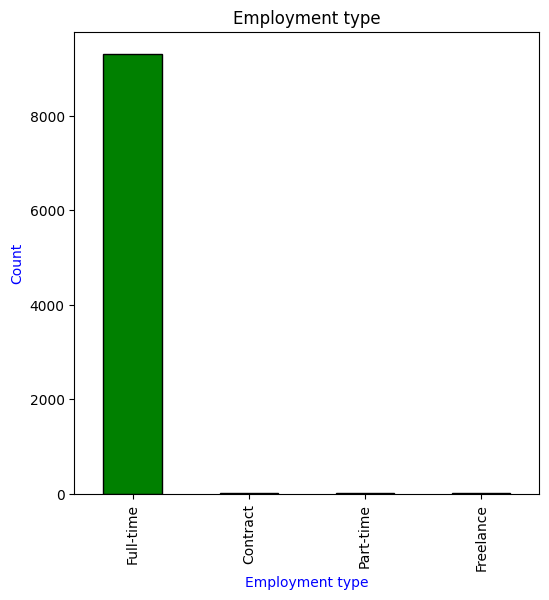

In [ ]:
plt.figure(figsize=(6,6))
type_employment.plot(kind='bar',title='Employment type', color='g', edgecolor='black')
plt.xlabel('Employment type', color='blue')
plt.ylabel('Count', color='blue')
plt.show

<font color="lightblue"> lets see the company size of those jobs

In [ ]:
jobsdata['company_size'].unique()

array(['L', 'M', 'S'], dtype=object)

In [ ]:
company_size=jobsdata['company_size'].value_counts()
company_size

M    8448
L     748
S     159
Name: company_size, dtype: int64

<function matplotlib.pyplot.show(close=None, block=None)>

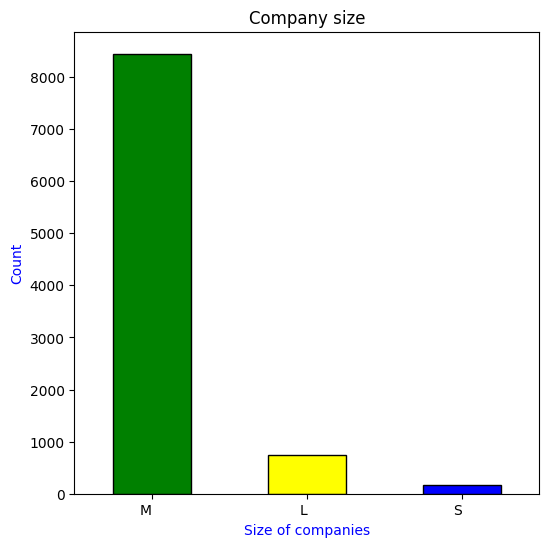

In [ ]:
plt.figure(figsize=(6,6))
company_size.plot(kind='bar',title='Company size', color=['green', 'yellow', 'blue'], edgecolor='black')
plt.xlabel('Size of companies', color='blue')
plt.ylabel('Count', color='blue')
plt.xticks(rotation=0, ha='right')
plt.show

<font color="lightblue"> the company locations:

In [ ]:
jobsdata['company_location'].unique()

array(['Germany', 'United States', 'United Kingdom', 'Canada', 'Spain',
       'Ireland', 'South Africa', 'Poland', 'France', 'Netherlands',
       'Luxembourg', 'Lithuania', 'Portugal', 'Gibraltar', 'Australia',
       'Colombia', 'Ukraine', 'Slovenia', 'Romania', 'Greece', 'India',
       'Latvia', 'Mauritius', 'Russia', 'Italy', 'South Korea', 'Estonia',
       'Czech Republic', 'Brazil', 'Qatar', 'Kenya', 'Denmark', 'Ghana',
       'Sweden', 'Turkey', 'Switzerland', 'Andorra', 'Ecuador', 'Mexico',
       'Israel', 'Nigeria', 'Saudi Arabia', 'Argentina', 'Japan',
       'Central African Republic', 'Finland', 'Singapore', 'Croatia',
       'Armenia', 'Bosnia and Herzegovina', 'Pakistan', 'Iran', 'Bahamas',
       'Austria', 'Puerto Rico', 'American Samoa', 'Thailand',
       'Philippines', 'Belgium', 'Egypt', 'Indonesia',
       'United Arab Emirates', 'Malaysia', 'Honduras', 'Algeria', 'Iraq',
       'China', 'New Zealand', 'Moldova', 'Malta'], dtype=object)

In [ ]:
company_location=jobsdata['company_location'].value_counts()
company_location

United States     8132
United Kingdom     449
Canada             226
Spain              113
Germany             72
                  ... 
Gibraltar            1
Ecuador              1
Andorra              1
Mauritius            1
Malta                1
Name: company_location, Length: 70, dtype: int64

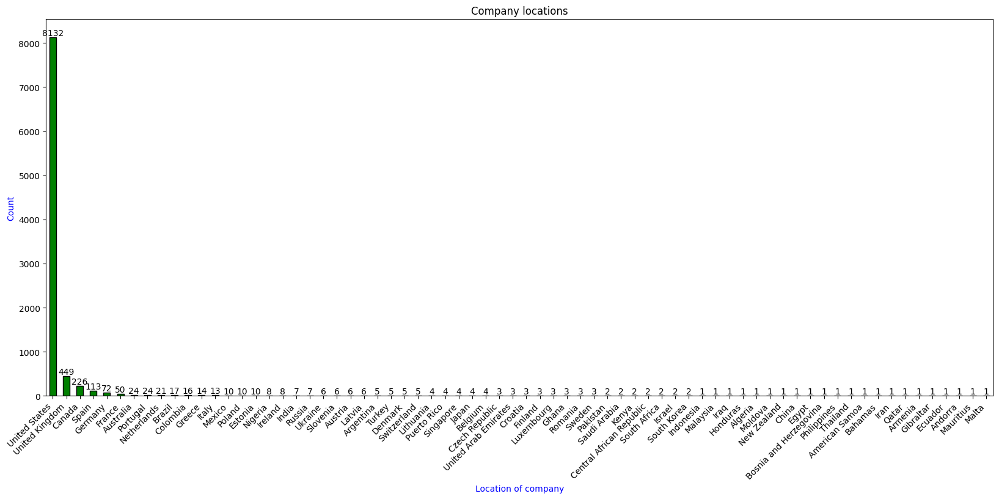

In [ ]:
plt.figure(figsize=(20,8))
company_location.plot(kind='bar' ,title='Company locations', color='g', edgecolor='black')
plt.xlabel('Location of company', color='blue')
plt.ylabel('Count', color='blue')
plt.xticks(rotation=45, ha='right')
for i, (location, count) in enumerate(company_location.items()):
    plt.text(i, count, str(count), ha='center', va='bottom')
plt.show()

<font color="lightblue"> we will represent them on the map now as well:

In [ ]:
# Dictionary of country coordinates
country_coordinates = {
    'Germany': [51.1657, 10.4515],
    'United States': [37.0902, -95.7129],
    'United Kingdom': [55.3781, -3.4360],
    'Canada': [56.1304, -106.3468],
    'Spain': [40.4637, -3.7492],
    'Ireland': [53.1424, -7.6921],
    'South Africa': [-30.5595, 22.9375],
    'Poland': [51.9194, 19.1451],
    'France': [46.6033, 1.8883],
    'Netherlands': [52.1326, 5.2913],
    'Luxembourg': [49.8153, 6.1296],
    'Lithuania': [55.1694, 23.8813],
    'Portugal': [39.3999, -8.2245],
    'Gibraltar': [36.1408, -5.3536],
    'Australia': [-25.2744, 133.7751],
    'Colombia': [4.5709, -74.2973],
    'Ukraine': [48.3794, 31.1656],
    'Slovenia': [46.1512, 14.9955],
    'Romania': [45.9432, 24.9668],
    'Greece': [39.0742, 21.8243],
    'India': [20.5937, 78.9629],
    'Latvia': [56.8796, 24.6032],
    'Mauritius': [-20.3484, 57.5522],
    'Russia': [61.5240, 105.3188],
    'Italy': [41.8719, 12.5674],
    'South Korea': [35.9078, 127.7669],
    'Estonia': [58.5953, 25.0136],
    'Czech Republic': [49.8175, 15.4730],
    'Brazil': [-14.2350, -51.9253],
    'Qatar': [25.3548, 51.1839],
    'Kenya': [-1.2864, 36.8172],
    'Denmark': [56.2639, 9.5018],
    'Ghana': [7.9465, -1.0232],
    'Sweden': [60.1282, 18.6435],
    'Turkey': [38.9637, 35.2433],
    'Switzerland': [46.8182, 8.2275],
    'Andorra': [42.5463, 1.6016],
    'Ecuador': [-1.8312, -78.1834],
    'Mexico': [23.6345, -102.5528],
    'Israel': [31.0461, 34.8516],
    'Nigeria': [9.0820, 8.6753],
    'Saudi Arabia': [23.8859, 45.0792],
    'Argentina': [-38.4161, -63.6167],
    'Japan': [36.2048, 138.2529],
    'Central African Republic': [6.6111, 20.9394],
    'Finland': [61.9241, 25.7482],
    'Singapore': [1.3521, 103.8198],
    'Croatia': [45.1000, 15.2000],
    'Armenia': [40.0691, 45.0382],
    'Bosnia and Herzegovina': [43.9159, 17.6791],
    'Pakistan': [30.3753, 69.3451],
    'Iran': [32.4279, 53.6880],
    'Bahamas': [25.0343, -77.3963],
    'Austria': [47.5162, 14.5501],
    'Puerto Rico': [18.2208, -66.5901],
    'American Samoa': [-14.2710, -170.1322],
    'Thailand': [15.8700, 100.9925],
    'Philippines': [12.8797, 121.7740],
    'Belgium': [50.5039, 4.4699],

}

path = "/content/drive/MyDrive/Colab Notebooks/OESON programming/jobs_in_data.csv"
jobsdata = pd.read_csv(path)

# Creating a map centered on a specific location
map_center = [0, 0]
map = folium.Map(location=map_center, zoom_start=2)

# Creating a MarkerCluster layer
marker_cluster = folium.plugins.MarkerCluster().add_to(map)

# we add markers to the map based on country coordinates
for index, row in jobsdata.iterrows():
    location = row['company_location']
    if location in country_coordinates:
        coordinates = country_coordinates[location]
        folium.Marker(
            location=coordinates,
            popup=location
        ).add_to(marker_cluster)

# we display the map
map

<font color="lightblue"> we will see now the residence of the employees

In [ ]:
jobsdata['employee_residence'].unique()

array(['Germany', 'United States', 'United Kingdom', 'Canada', 'Spain',
       'Ireland', 'South Africa', 'Poland', 'France', 'Czech Republic',
       'Netherlands', 'Pakistan', 'Ukraine', 'Lithuania', 'Portugal',
       'Australia', 'Uganda', 'Colombia', 'Italy', 'Slovenia', 'Romania',
       'Greece', 'India', 'Latvia', 'Mauritius', 'Armenia', 'Croatia',
       'Thailand', 'South Korea', 'Estonia', 'Turkey', 'Philippines',
       'Brazil', 'Qatar', 'Russia', 'Kenya', 'Tunisia', 'Ghana',
       'Belgium', 'Switzerland', 'Andorra', 'Ecuador', 'Peru', 'Mexico',
       'Moldova', 'Nigeria', 'Saudi Arabia', 'Argentina', 'Egypt',
       'Uzbekistan', 'Georgia', 'Central African Republic', 'Finland',
       'Austria', 'Singapore', 'Sweden', 'Kuwait', 'Cyprus',
       'Bosnia and Herzegovina', 'Iran', 'American Samoa', 'China',
       'Costa Rica', 'Chile', 'Puerto Rico', 'Denmark', 'Bolivia',
       'Dominican Republic', 'Indonesia', 'United Arab Emirates',
       'Malaysia', 'Japan', 'Hond

In [ ]:
employee_residence=jobsdata['employee_residence'].value_counts()
employee_residence

United States     8086
United Kingdom     442
Canada             224
Spain              117
Germany             66
                  ... 
Andorra              1
Qatar                1
Mauritius            1
Uganda               1
Malta                1
Name: employee_residence, Length: 83, dtype: int64

<font color="lightblue"> Most of them are in US

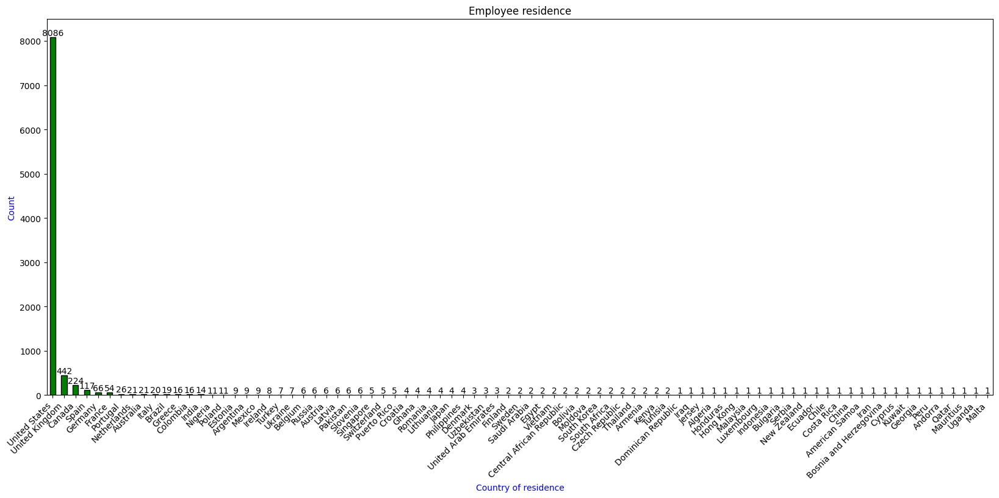

In [ ]:
plt.figure(figsize=(20,8))
employee_residence.plot(kind='bar' ,title='Employee residence', color='g', edgecolor='black')
plt.xlabel('Country of residence', color='blue')
plt.ylabel('Count', color='blue')
plt.xticks(rotation=45, ha='right')
for i, (location, count) in enumerate(employee_residence.items()):
    plt.text(i, count, str(count), ha='center', va='bottom')
plt.show()

In [ ]:
country_coordinates = {
    'Germany': [51.1657, 10.4515],
    'United States': [37.0902, -95.7129],
    'United Kingdom': [55.3781, -3.4360],
    'Canada': [56.1304, -106.3468],
    'Spain': [40.4637, -3.7492],
    'Ireland': [53.1424, -7.6921],
    'South Africa': [-30.5595, 22.9375],
    'Poland': [51.9194, 19.1451],
    'France': [46.6033, 1.8883],
    'Czech Republic': [49.8175, 15.4730],
    'Netherlands': [52.1326, 5.2913],
    'Pakistan': [30.3753, 69.3451],
    'Ukraine': [48.3794, 31.1656],
    'Lithuania': [55.1694, 23.8813],
    'Portugal': [39.3999, -8.2245],
    'Australia': [-25.2744, 133.7751],
    'Uganda': [1.3733, 32.2903],
    'Colombia': [4.5709, -74.2973],
    'Italy': [41.8719, 12.5674],
    'Slovenia': [46.1512, 14.9955],
    'Romania': [45.9432, 24.9668],
    'Greece': [39.0742, 21.8243],
    'India': [20.5937, 78.9629],
    'Latvia': [56.8796, 24.6032],
    'Mauritius': [-20.3484, 57.5522],
    'Armenia': [40.0691, 45.0382],
    'Croatia': [45.1000, 15.2000],
    'Thailand': [15.8700, 100.9925],
    'South Korea': [35.9078, 127.7669],
    'Estonia': [58.5953, 25.0136],
    'Turkey': [38.9637, 35.2433],
    'Philippines': [12.8797, 121.7740],
    'Brazil': [-14.2350, -51.9253],
    'Qatar': [25.3548, 51.1839],
    'Russia': [61.5240, 105.3188],
    'Kenya': [0.0236, 37.9062],
    'Tunisia': [33.8869, 9.5375],
    'Ghana': [7.9465, -1.0232],
    'Belgium': [50.5039, 4.4699],
    'Switzerland': [46.8182, 8.2275],
    'Andorra': [42.5063, 1.5218],
    'Ecuador': [-1.8312, -78.1834],
    'Peru': [-9.1899, -75.0152],
    'Mexico': [23.6345, -102.5528],
    'Moldova': [47.4116, 28.3699],
    'Nigeria': [9.0820, 8.6753],
    'Saudi Arabia': [23.8859, 45.0792],
    'Argentina': [-38.4161, -63.6167],
    'Egypt': [26.8206, 30.8025],
    'Uzbekistan': [41.3775, 64.5853],
    'Georgia': [42.3154, 43.3569],
    'Central African Republic': [6.6111, 20.9394],
    'Finland': [61.9241, 25.7482],
    'Austria': [47.5162, 14.5501],
    'Singapore': [1.3521, 103.8198],
    'Sweden': [60.1282, 18.6435],
    'Kuwait': [29.3117, 47.4818],
    'Cyprus': [35.1264, 33.4299],
    'Bosnia and Herzegovina': [43.9159, 17.6791],
    'Iran': [32.4279, 53.6880],
    'American Samoa': [-14.2710, -170.1322],
    'China': [35.8617, 104.1954],
    'Costa Rica': [9.7489, -83.7534],
    'Chile': [-35.6751, -71.5430],
    'Puerto Rico': [18.2208, -66.5901],
    'Denmark': [56.2639, 9.5018],
    'Bolivia': [-16.2902, -63.5887],
    'Dominican Republic': [18.7357, -70.1627],
    'Indonesia': [-0.7893, 113.9213],
    'United Arab Emirates': [23.4241, 53.8478],
    'Malaysia': [4.2105, 101.9758],
    'Japan': [36.2048, 138.2529],
    'Honduras': [15.2000, -86.2419],
    'Algeria': [28.0339, 1.6596],
    'Vietnam': [14.0583, 108.2772],
    'Iraq': [33.2232, 43.6793],
    'Bulgaria': [42.7339, 25.4858],
    'Jersey': [49.2144, -2.1313],
    'Serbia': [44.0165, 21.0059],
    'New Zealand': [-40.9006, 174.8860],
    'Hong Kong': [22.3193, 114.1694],
    'Luxembourg': [49.8153, 6.1296],
    'Malta': [35.9375, 14.3754]
}

map_center = [0, 0]
map = folium.Map(location=map_center, zoom_start=2)


marker_cluster = folium.plugins.MarkerCluster().add_to(map)

# we add markers to the map based on country coordinates
for index, row in jobsdata.iterrows():
    location = row['employee_residence']
    if location in country_coordinates:
        coordinates = country_coordinates[location]
        folium.Marker(
            location=coordinates,
            popup=location
        ).add_to(marker_cluster)

map

<font color="lightblue"> we will see the type of work setting:

In [ ]:
jobsdata['work_setting'].unique()

array(['Hybrid', 'In-person', 'Remote'], dtype=object)

In [ ]:
work_setting=jobsdata['work_setting'].value_counts()
work_setting

In-person    5730
Remote       3434
Hybrid        191
Name: work_setting, dtype: int64

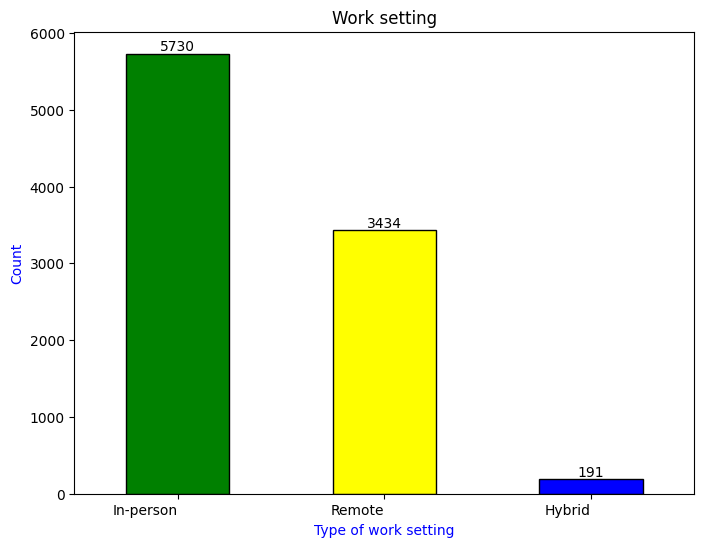

In [ ]:
plt.figure(figsize=(8,6))
work_setting.plot(kind='bar' ,title='Work setting', color=['green', 'yellow', 'blue'], edgecolor='black')
plt.xlabel('Type of work setting', color='blue')
plt.ylabel('Count', color='blue')
plt.xticks(rotation=0, ha='right')
for i, (location, count) in enumerate(work_setting.items()):
    plt.text(i, count, str(count), ha='center', va='bottom')
plt.show()

<font color="lightblue"> we will analyse the experience levels:

In [ ]:
jobsdata['experience_level'].unique()

array(['Mid-level', 'Senior', 'Executive', 'Entry-level'], dtype=object)

In [ ]:
custom_order = ['Entry-level', 'Mid-level', 'Senior', 'Executive']
experience_level = pd.Categorical(jobsdata['experience_level'], categories=custom_order, ordered=True)
experience_level_counts = experience_level.value_counts().sort_index()
experience_level_counts

Entry-level     496
Mid-level      1869
Senior         6709
Executive       281
dtype: int64

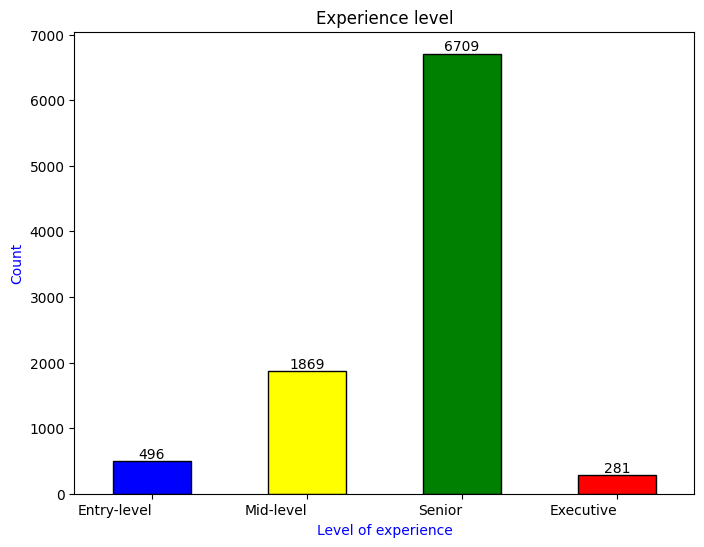

In [ ]:
plt.figure(figsize=(8,6))
experience_level_counts.plot(kind='bar' ,title='Experience level', color=['blue', 'yellow', 'green','red'], edgecolor='black')
plt.xlabel('Level of experience', color='blue')
plt.ylabel('Count', color='blue')
plt.xticks(rotation=0, ha='right')
for i, (location, count) in enumerate(experience_level_counts.items()):
    plt.text(i, count, str(count), ha='center', va='bottom')
plt.show()

<font color="lightblue"> we will analyse the salaries in US dollars:

In [ ]:
jobsdata['salary_in_usd'].unique()

array([ 95012, 186000,  81800, ..., 423000,  28369, 412000])

In [ ]:
salary_in_usd=jobsdata['salary_in_usd'].value_counts()
salary_in_usd

150000    206
130000    189
160000    183
100000    177
120000    161
         ... 
65100       1
44640       1
239080      1
129562      1
412000      1
Name: salary_in_usd, Length: 1786, dtype: int64

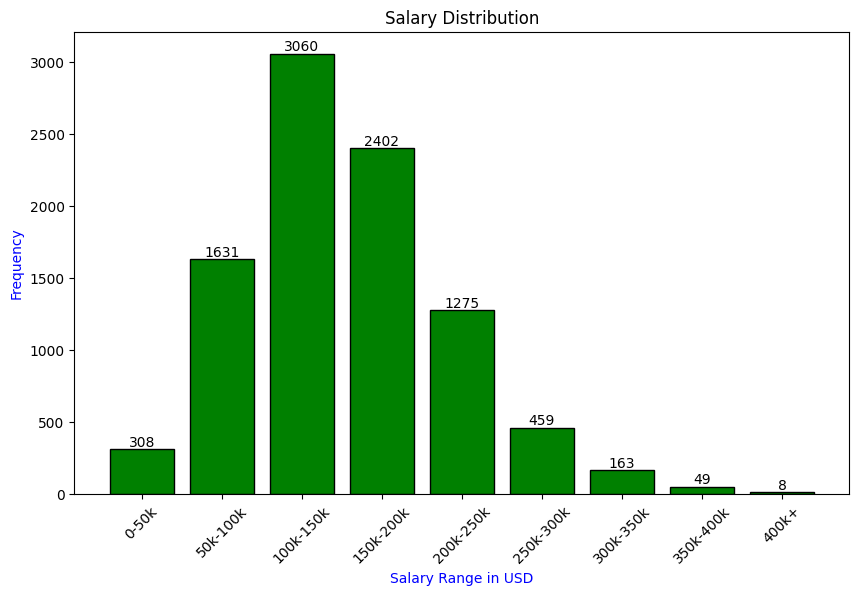

In [ ]:
# we define salary ranges
salary_ranges = ['0-50k', '50k-100k', '100k-150k', '150k-200k', '200k-250k', '250k-300k', '300k-350k', '350k-400k', '400k+']

# then count the frequencies within each salary range
salary_counts, _ = np.histogram(jobsdata['salary_in_usd'], bins=[0, 50000, 100000, 150000, 200000, 250000, 300000, 350000, 400000, np.inf])

# then create the bar plot
plt.figure(figsize=(10, 6))
plt.bar(range(len(salary_ranges)), salary_counts, color='g', edgecolor='black')
plt.xticks(range(len(salary_ranges)), salary_ranges, rotation=45)
plt.title('Salary Distribution')
plt.xlabel('Salary Range in USD', color='blue')
plt.ylabel('Frequency', color='blue')
for i, count in enumerate(salary_counts):
    plt.text(i, count, str(count), ha='center', va='bottom')

plt.show()

<font color="lightblue"> under an histogram a bit more accurate with the ranges every 25k:

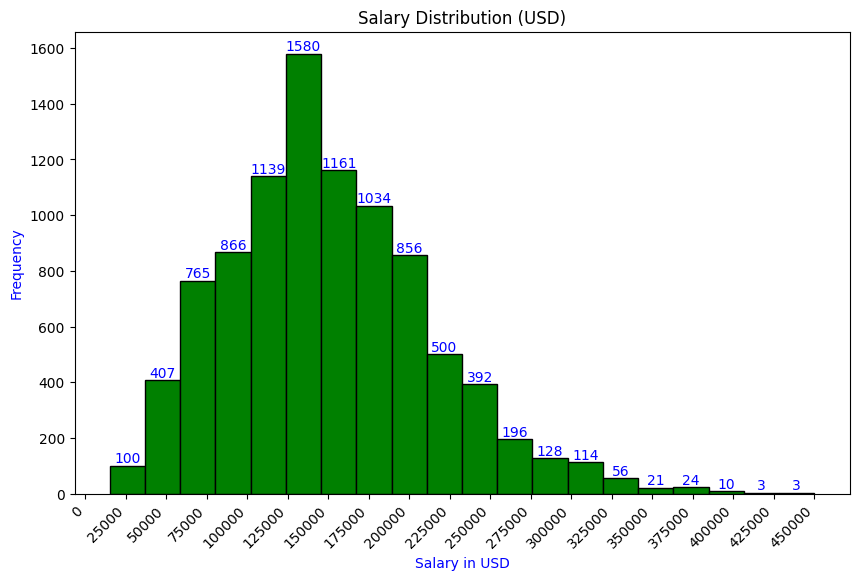

In [ ]:
# We define the number of bins and tick interval this time
num_bins = 20
tick_interval = 25000

plt.figure(figsize=(10, 6))
plt.hist(jobsdata['salary_in_usd'], bins=num_bins, color='g', edgecolor='black')
plt.title('Salary Distribution (USD)')
plt.xlabel('Salary in USD', color='blue')
plt.ylabel('Frequency', color='blue')

# we set the x-axis ticks
plt.xticks(np.arange(0, jobsdata['salary_in_usd'].max()+tick_interval, tick_interval))

# and then we add counts on top of each bar
for i in range(num_bins):
    count = int(plt.gca().patches[i].get_height())
    plt.text(plt.gca().patches[i].get_x() + plt.gca().patches[i].get_width() / 2, count, str(count),
             ha='center', va='bottom', color='blue')
plt.xticks(rotation=45, ha='right')
plt.show()

<font color="lightblue"> We have already analysed some of the aspect requested and went beyond with some extra insight. We will now complete the missing aspect to analyse:

*   Get Average Salaries for each year
*   Visualize average salaries by job titles and the top job_titles with highest average salaries and least average salaries
*   Visualize Average Salaries for the most common job titles
*   Average Salaries by Job Category
*   Visualize average salary based on employee residence and company location
*   Visualize salary based on experience level
*   Visualize average salary based on employment type, work setting and company_size










<font color="lightblue">Average Salaries for each year

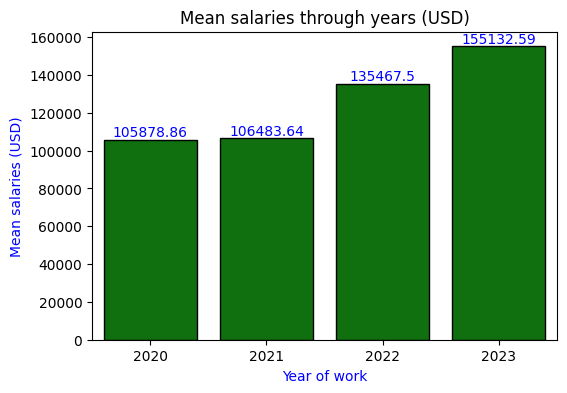

In [ ]:
jobsdata['work_year'] = pd.to_datetime(jobsdata['work_year'], format='%Y')

# Sorting through years
sortbyyear = jobsdata[jobsdata['work_year'].dt.year.isin([2020, 2021, 2022, 2023])]

# then we calculate the mean salaries
mean_salaries = sortbyyear.groupby(sortbyyear['work_year'].dt.year)['salary_in_usd'].mean().reset_index()
mean_salaries.columns = ['Year of work', 'Mean salaries (USD)']

fig, ax = plt.subplots(figsize=(6, 4))
sns.barplot(x='Year of work', y='Mean salaries (USD)', data=mean_salaries, color='g', edgecolor='black', ax=ax)
ax.set_title('Mean salaries through years (USD)')
ax.set_xlabel('Year of work', color='blue')
ax.set_ylabel('Mean salaries (USD)', color='blue')
for index, row in mean_salaries.iterrows():
    plt.text(row.name, row['Mean salaries (USD)'], round(row['Mean salaries (USD)'], 2), ha='center', va='bottom', color='blue')
plt.show()

<font color="lightblue">Average salaries for the most common job salaries (top 20 job titles)

<ipython-input-46-1d04535f0dee>:11: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.



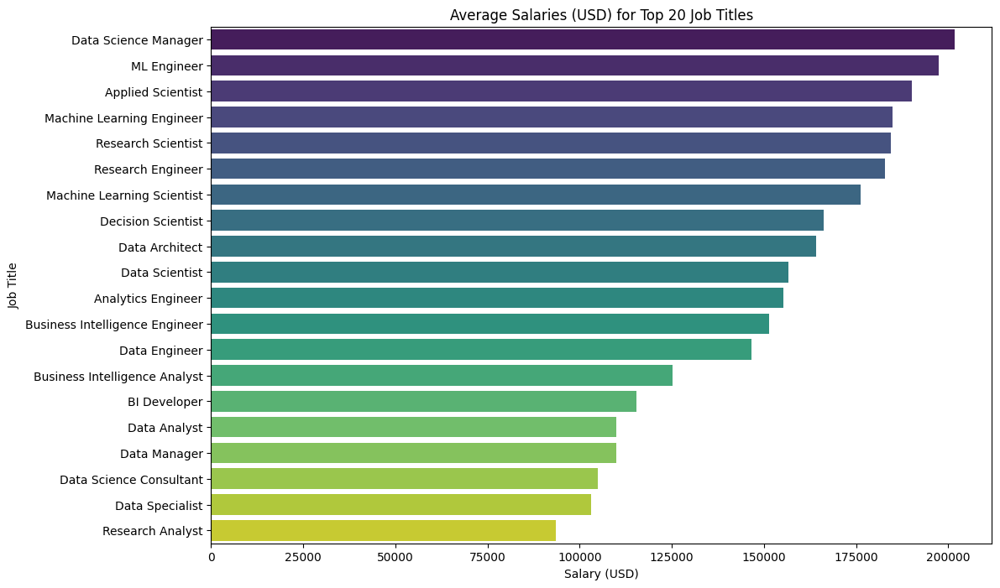

In [ ]:
# here we calculate the mean salaries for the top 20 job titles
mean_salaries_top_jobs = jobsdata[jobsdata['job_title'].isin(most_frequent_jobs.index)].groupby('job_title')['salary_in_usd'].mean().reset_index()

# for order we sort the salaries in descending order
mean_salaries_top_jobs = mean_salaries_top_jobs.sort_values('salary_in_usd', ascending=False)

# the top 20 job titles
mean_salaries_top_jobs = mean_salaries_top_jobs.head(20)

plt.figure(figsize=(12, 8))
ax = sns.barplot(x='salary_in_usd', y='job_title', data=mean_salaries_top_jobs, palette='viridis')
plt.title('Average Salaries (USD) for Top 20 Job Titles')
plt.xlabel('Salary (USD)')
plt.ylabel('Job Title')
plt.show()

<font color="lightblue">Average salaries for the most common job salaries (top 20 job titles) filtered by year

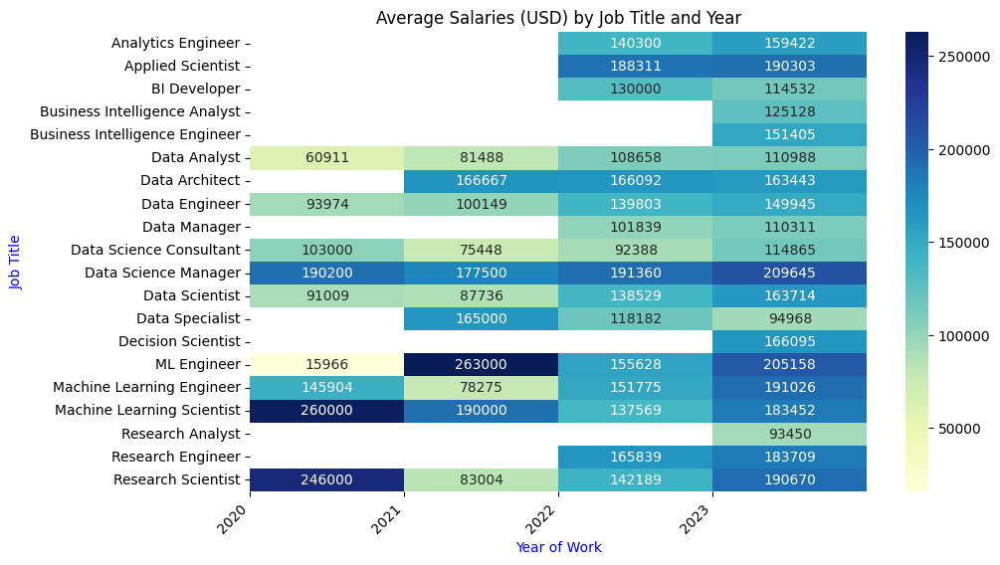

In [ ]:
# here we calculate the mean salaries for the top 20 job titles
mean_salaries_top_jobs = sortbyyear[sortbyyear['job_title'].isin(most_frequent_jobs.index)].groupby(['work_year', 'job_title'])['salary_in_usd'].mean().reset_index()

# then we pivot the data to create a matrix of mean salaries for each job title and year
pivot_table = mean_salaries_top_jobs.pivot(index='job_title', columns='work_year', values='salary_in_usd')

plt.figure(figsize=(10, 6))
sns.heatmap(pivot_table, cmap='YlGnBu', annot=True, fmt=".0f", cbar=True)
plt.title('Average Salaries (USD) by Job Title and Year')
plt.xlabel('Year of Work', color='blue')
plt.ylabel('Job Title', color='blue')
year_labels = [str(pd.to_datetime(date).year) for date in pivot_table.columns]
plt.xticks(ticks=range(len(year_labels)), labels=year_labels, rotation=45, ha='right')
plt.show()

<font color="lightblue">Here top 10 job titles with highest average salaries and just after 10 job titles with the least average salaries

<ipython-input-48-4aa0a175d83a>:14: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.



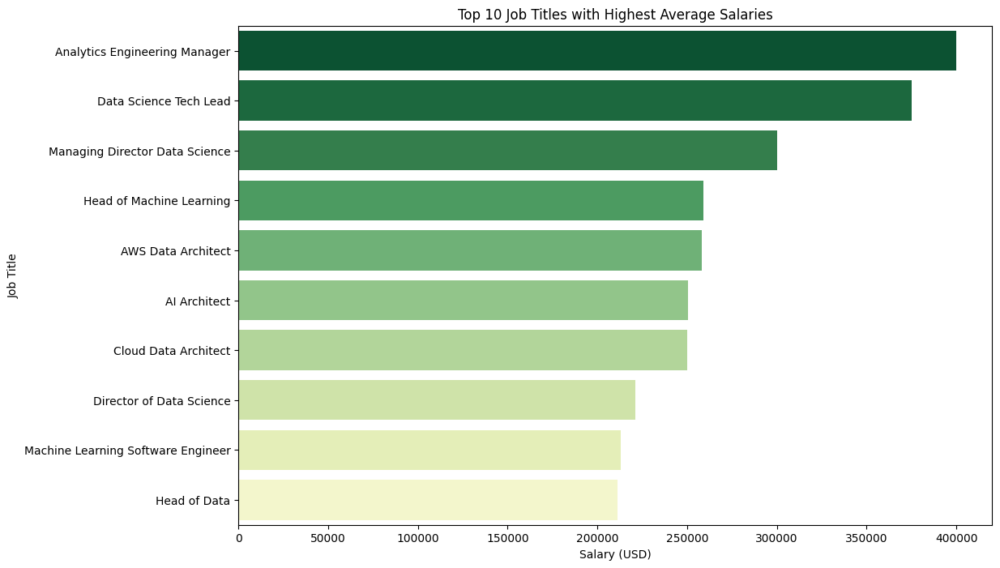

In [ ]:
# we calculate the mean salaries for the job titles
mean_salaries = jobsdata.groupby('job_title')['salary_in_usd'].mean().reset_index()

# we sort the mean salaries in descending order
mean_salaries = mean_salaries.sort_values('salary_in_usd', ascending=False)

# we select the top 10 job titles
top_10_jobs = mean_salaries.head(10)

# then we define the color palette from yellow to green (inverted)
colors = sns.color_palette("YlGn_r", n_colors=len(top_10_jobs))

plt.figure(figsize=(12, 8))
ax = sns.barplot(x='salary_in_usd', y='job_title', data=top_10_jobs, palette=colors)
plt.title('Top 10 Job Titles with Highest Average Salaries')
plt.xlabel('Salary (USD)')
plt.ylabel('Job Title')
plt.show()

<ipython-input-49-0bbca109bd4a>:14: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.



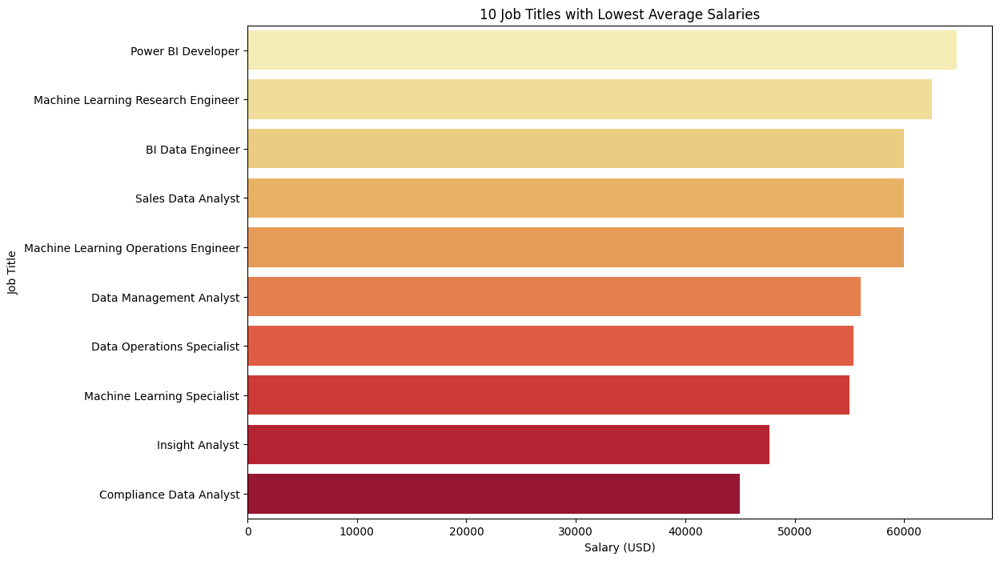

In [ ]:
# we calculate the mean salaries for the job titles
mean_salaries = jobsdata.groupby('job_title')['salary_in_usd'].mean().reset_index()

# we sort the mean salaries in ascending order
mean_salaries = mean_salaries.sort_values('salary_in_usd', ascending=False)

# we select the 10 job titles with the lowest average salaries
lowest_10_jobs = mean_salaries.tail(10)  # Use `tail` instead of `head`

# then we define the color palette from yellow to red
colors = sns.color_palette("YlOrRd", n_colors=len(lowest_10_jobs))

plt.figure(figsize=(12, 8))
ax = sns.barplot(x='salary_in_usd', y='job_title', data=lowest_10_jobs, palette=colors)
plt.title('10 Job Titles with Lowest Average Salaries')
plt.xlabel('Salary (USD)')
plt.ylabel('Job Title')
plt.show()

<font color="lightblue">Average salaries by job categories (10)

<ipython-input-50-7c105d045e6d>:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.



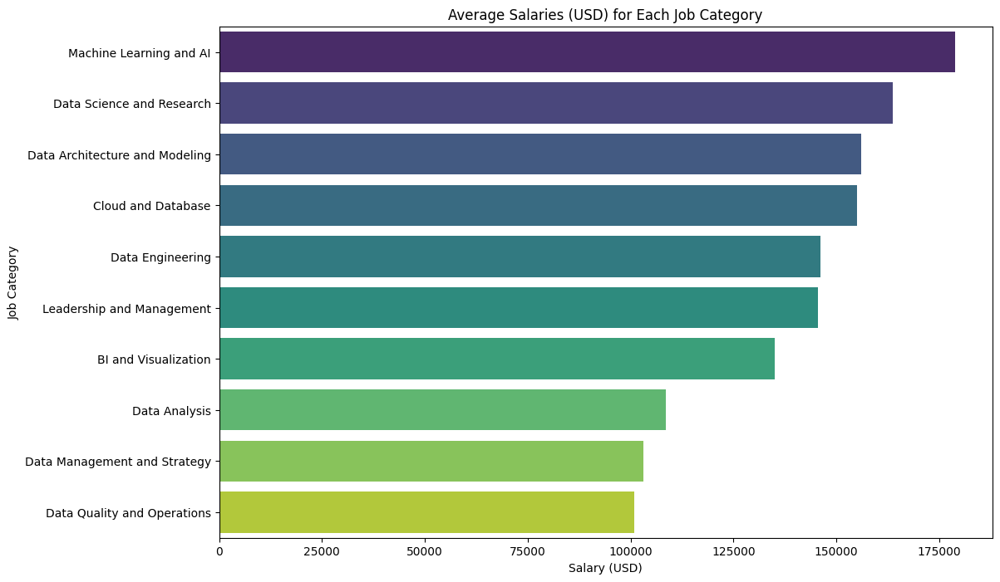

In [ ]:
mean_salaries_job_category = jobsdata.groupby('job_category')['salary_in_usd'].mean().reset_index()

mean_salaries_job_category = mean_salaries_job_category.sort_values(by='salary_in_usd', ascending=False)

plt.figure(figsize=(12, 8))
sns.barplot(x='salary_in_usd', y='job_category', data=mean_salaries_job_category, palette='viridis')
plt.title('Average Salaries (USD) for Each Job Category')
plt.xlabel('Salary (USD)')
plt.ylabel('Job Category')
plt.show()

<font color="lightblue">Average salaries by job categories (10) filtering by year

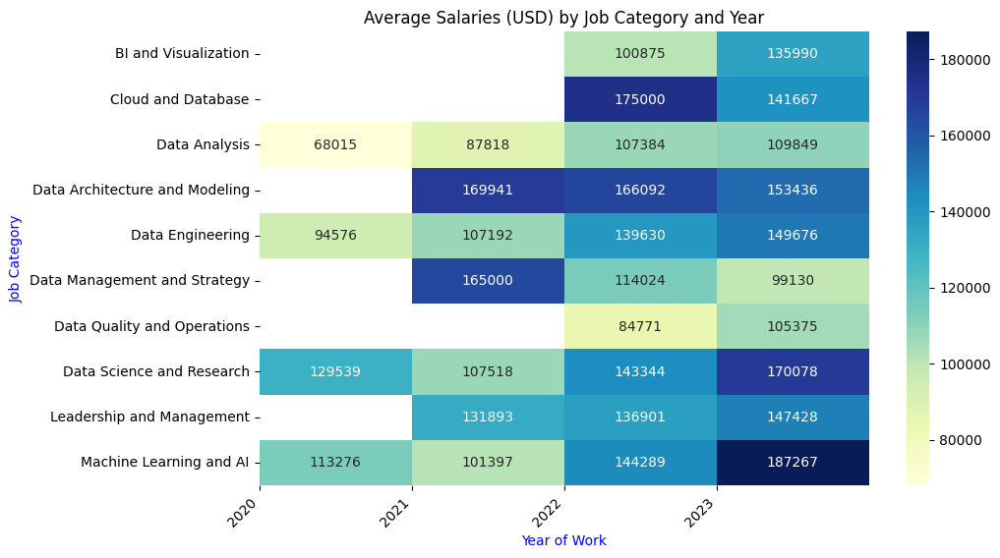

In [ ]:
pivot_table_job_category_year = jobsdata.pivot_table(index='job_category', columns='work_year', values='salary_in_usd', aggfunc='mean')

plt.figure(figsize=(10, 6))
sns.heatmap(pivot_table_job_category_year, cmap='YlGnBu', annot=True, fmt=".0f", cbar=True)
plt.title('Average Salaries (USD) by Job Category and Year')
plt.xlabel('Year of Work', color='blue')
plt.ylabel('Job Category', color='blue')
year_labels = [str(pd.to_datetime(date).year) for date in pivot_table_job_category_year.columns]
plt.xticks(ticks=range(len(year_labels)), labels=year_labels, rotation=45, ha='right')
plt.show()

<font color="lightblue">Visualize average salary based on employee residence and company location

<ipython-input-52-266598fa0d40>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.



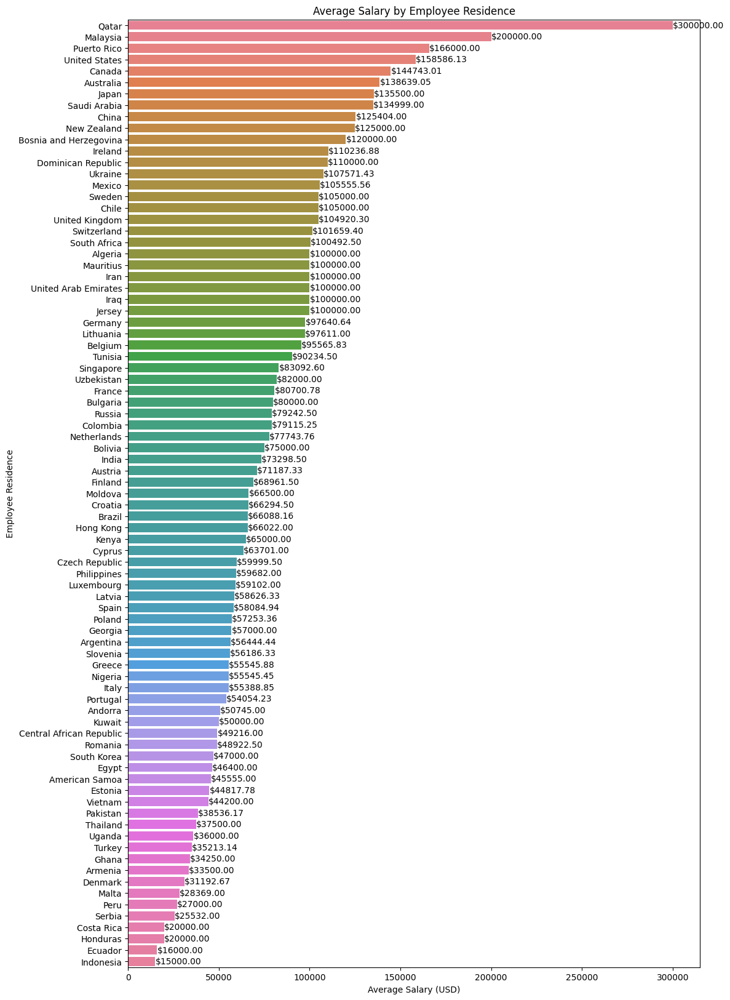

In [ ]:
# we calculate the average salary by employee residence
avg_salary_by_residence = jobsdata.groupby('employee_residence')['salary_in_usd'].mean().sort_values(ascending=False).reset_index()

# we set a color palette with different colors for each country of residence
num_countries = len(avg_salary_by_residence)
palette = sns.color_palette("husl", num_countries)

# we plot the horizontal bar chart using Seaborn with the custom palette
plt.figure(figsize=(12, 20))
sns.barplot(x='salary_in_usd', y='employee_residence', data=avg_salary_by_residence, palette=palette)
plt.title('Average Salary by Employee Residence')
plt.xlabel('Average Salary (USD)')
plt.ylabel('Employee Residence')

# then we add value labels on the right side of each bar
for i, salary in enumerate(avg_salary_by_residence['salary_in_usd']):
    plt.text(salary, i, f"${salary:.2f}", ha='left', va='center')

plt.show()

<ipython-input-53-d036b8d5f020>:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.



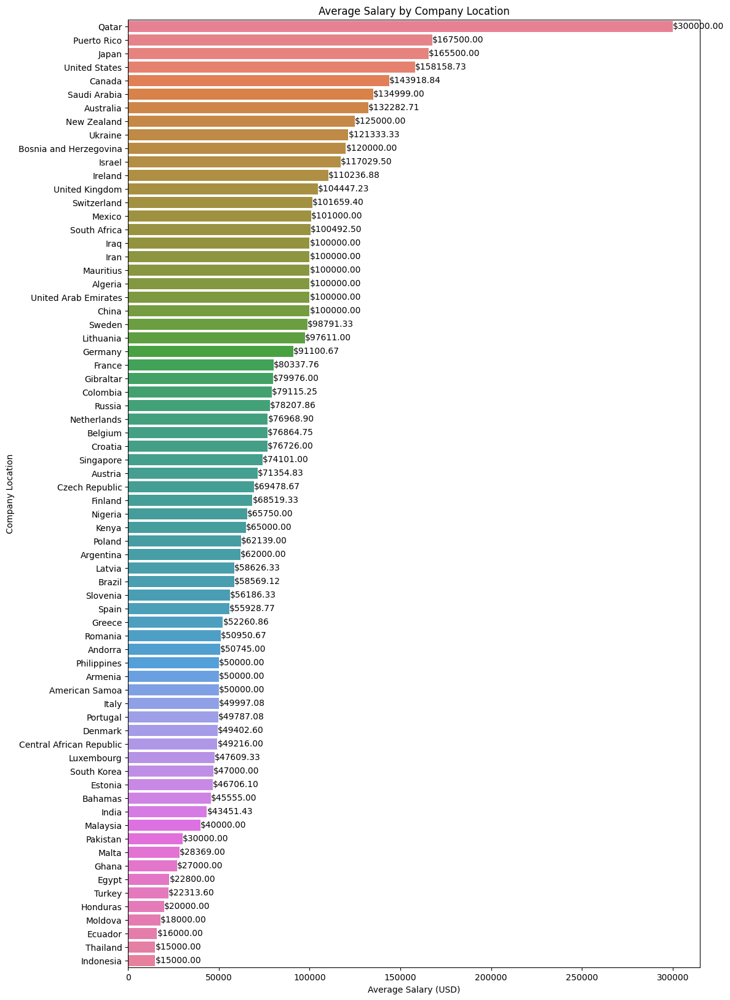

In [ ]:
# we calculate the average salary by company location
avg_salary_by_location = jobsdata.groupby('company_location')['salary_in_usd'].mean().sort_values(ascending=False).reset_index()

# we set a color palette with different colors for each company location
num_locations = len(avg_salary_by_location)
palette = sns.color_palette("husl", num_locations)

# we plot the horizontal bar chart using Seaborn with the custom palette
plt.figure(figsize=(12, 20))
sns.barplot(x='salary_in_usd', y='company_location', data=avg_salary_by_location, palette=palette)
plt.title('Average Salary by Company Location')
plt.xlabel('Average Salary (USD)')
plt.ylabel('Company Location')

# then we add value labels on the right side of each bar
for i, salary in enumerate(avg_salary_by_location['salary_in_usd']):
    plt.text(salary, i, f"${salary:.2f}", ha='left', va='center')

plt.show()

<font color="lightblue">Visualize salary based on experience level

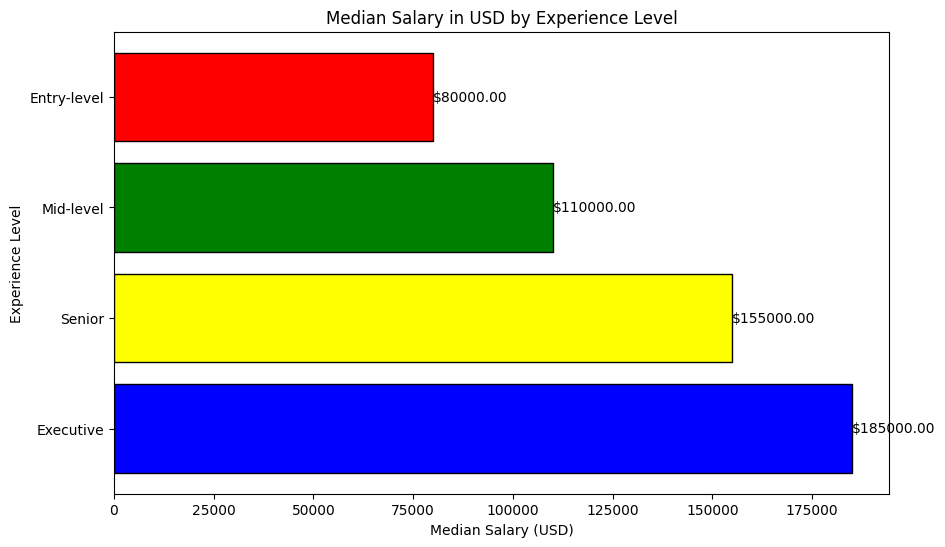

In [ ]:
usd_salaries = jobsdata[jobsdata['salary_in_usd'].notnull()]
median_salary_by_experience = usd_salaries.groupby('experience_level')['salary_in_usd'].median().sort_values(ascending=False)

# we define a color palette with different colors for each experience level
color_palette = ['blue', 'yellow', 'green', 'red']

# we plot the horizontal bar chart using matplotlib with custom colors
plt.figure(figsize=(10, 6))
bars = plt.barh(median_salary_by_experience.index, median_salary_by_experience.values, color=color_palette, edgecolor='black')

# then we add value labels on the right side of each bar
for bar in bars:
    width = bar.get_width()
    plt.text(width, bar.get_y() + bar.get_height() / 2, f"${width:.2f}", ha='left', va='center')

plt.title('Median Salary in USD by Experience Level')
plt.xlabel('Median Salary (USD)')
plt.ylabel('Experience Level')
plt.show()

<font color="lightblue">Visualize average salary based on employment type, work setting and company_size

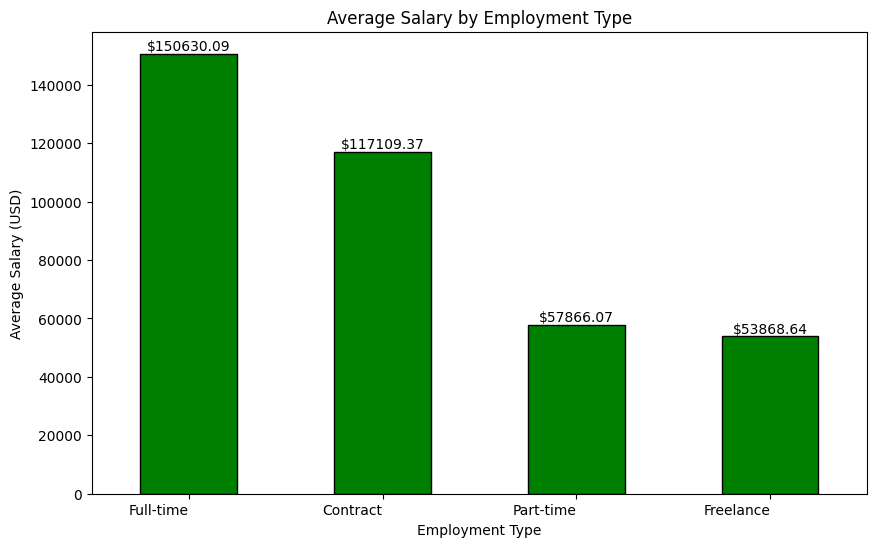

In [ ]:
# we calculate the average salary by employment type
average_salary_by_employment_type = jobsdata.groupby('employment_type')['salary_in_usd'].mean().sort_values(ascending=False)

# we plot the bar chart using matplotlib
plt.figure(figsize=(10, 6))
average_salary_by_employment_type.plot(kind='bar', color='g', edgecolor='black')
plt.title('Average Salary by Employment Type')
plt.xlabel('Employment Type')
plt.ylabel('Average Salary (USD)')

# then we add value labels on top of each bar
for i, salary in enumerate(average_salary_by_employment_type):
    plt.text(i, salary, f"${salary:.2f}", ha='center', va='bottom')

plt.xticks(rotation=0, ha='right')
plt.show()

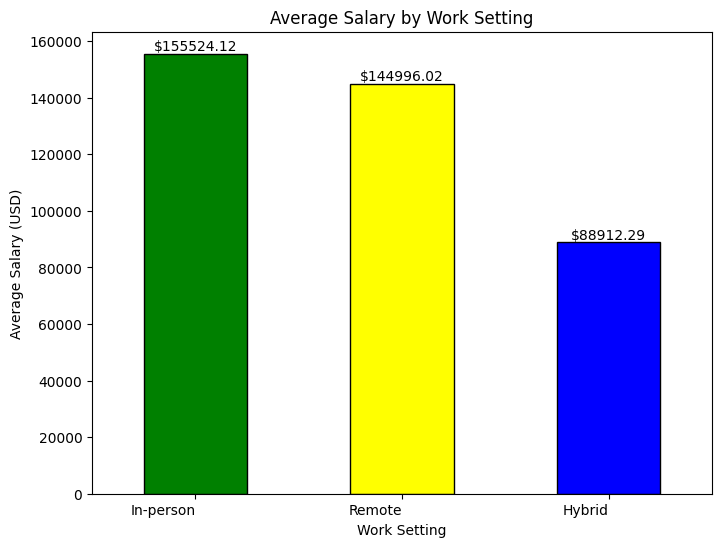

In [ ]:
# we calculate the average salary by work setting
average_salary_by_work_setting = jobsdata.groupby('work_setting')['salary_in_usd'].mean().sort_values(ascending=False)

# we plot the bar chart using matplotlib
plt.figure(figsize=(8,6))
average_salary_by_work_setting.plot(kind='bar', color=['green', 'yellow', 'blue'], edgecolor='black')
plt.title('Average Salary by Work Setting')
plt.xlabel('Work Setting')
plt.ylabel('Average Salary (USD)')

# then we add value labels on top of each bar
for i, salary in enumerate(average_salary_by_work_setting):
    plt.text(i, salary, f"${salary:.2f}", ha='center', va='bottom')

plt.xticks(rotation=0, ha='right')
plt.show()

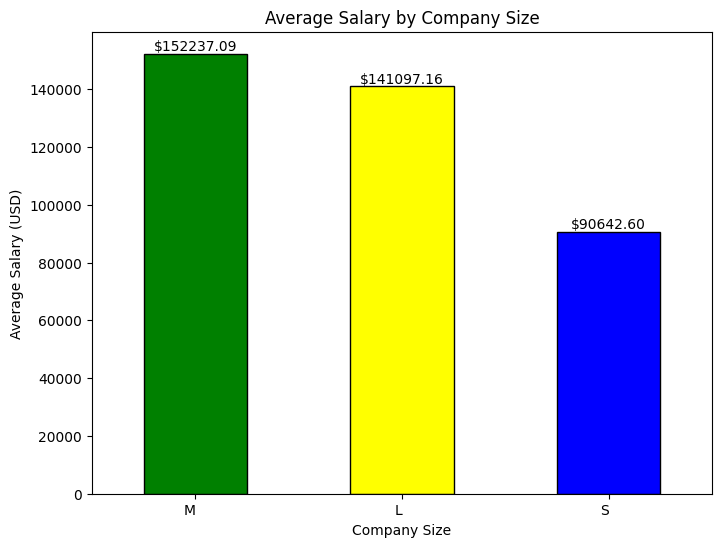

In [ ]:
# we calculate the average salary by company size
average_salary_by_company_size = jobsdata.groupby('company_size')['salary_in_usd'].mean().sort_values(ascending=False)

# then we plot the bar chart using matplotlib
plt.figure(figsize=(8,6))
average_salary_by_company_size.plot(kind='bar', color=['green', 'yellow', 'blue'], edgecolor='black')
plt.title('Average Salary by Company Size')
plt.xlabel('Company Size')
plt.ylabel('Average Salary (USD)')

# we add value labels on top of each bar
for i, salary in enumerate(average_salary_by_company_size):
    plt.text(i, salary, f"${salary:.2f}", ha='center', va='bottom')

plt.xticks(rotation=0, ha='right')
plt.show()